<a href="https://colab.research.google.com/github/GuMadikizela/Madikizela/blob/main/Pdanpart2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
#Step 1: Import the necessary library
#code attribution
#https://eur03.safelinks.protection.outlook.com/?url=https%3A%2F%2Fyoutu.be%2FYVC1FBdFym0%3Fsi%3DQlvKaD1c01qW4PPZ&data=05%7C02%7CST10480399%40vcconnect.edu.za%7C45cfad59946f497dd06908dd9df8453e%7Ce10c8f44f469448fbc0dd781288ff01b%7C0%7C0%7C638840411864682545%7CUnknown%7CTWFpbGZsb3d8eyJFbXB0eU1hcGkiOnRydWUsIlYiOiIwLjAuMDAwMCIsIlAiOiJXaW4zMiIsIkFOIjoiTWFpbCIsIldUIjoyfQ%3D%3D%7C0%7C%7C%7C&sdata=m58i25IkjI8MqpG%2F7wN5%2Fi%2BQDilP74o1vGTJYpet7q8%3D&reserved=0
#this code was taken from youtube
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from matplotlib import style
from sklearn.linear_model import LogisticRegression
# %%
#from sklern.processing import onehotEncoder, standardScaler #This line had a typo in the module name. It should be 'sklearn' instead of 'sklern'
from sklearn.preprocessing import OneHotEncoder, StandardScaler #Importing necessary modules for preprocessing
from sklearn.compose import ColumnTransformer #Importing ColumnTransformer for combining transformers
from sklearn.pipeline import Pipeline #Importing Pipeline for creating a pipeline of transformers and estimators
from sklearn.svm import LinearSVC #Importing LinearSVC for creating a linear support vector classifier
from sklearn.model_selection import train_test_split #Importing train_test_split for splitting data into training and testing sets
# %%
from sklearn.metrics import confusion_matrix
# %%
from sklearn.metrics import precision_score, f1_score, recall_score # Changed 'fr_score' to 'f1_score'
# %%

In [ ]:
#Step 2: Read Dataset Step
#code attribution

#this code was taken from youtube
import pandas as pd
df=pd.read_csv ('/content/data.csv')
df

,id,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,...,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst,Unnamed: 32
0,842302,M,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.30010,0.14710,...,17.33,184.60,2019.0,0.16220,0.66560,0.7119,0.2654,0.4601,0.11890,NaN
1,842517,M,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.08690,0.07017,...,23.41,158.80,1956.0,0.12380,0.18660,0.2416,0.1860,0.2750,0.08902,NaN
2,84300903,M,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.19740,0.12790,...,25.53,152.50,1709.0,0.14440,0.42450,0.4504,0.2430,0.3613,0.08758,NaN
3,84348301,M,11.42,20.38,77.58,386.1,0.14250,0.28390,0.24140,0.10520,...,26.50,98.87,567.7,0.20980,0.86630,0.6869,0.2575,0.6638,0.17300,NaN
4,84358402,M,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.19800,0.10430,...,16.67,152.20,1575.0,0.13740,0.20500,0.4000,0.1625,0.2364,0.07678,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
564,926424,M,21.56,22.39,142.00,1479.0,0.11100,0.11590,0.24390,0.13890,...,26.40,166.10,2027.0,0.14100,0.21130,0.4107,0.2216,0.2060,0.07115,NaN
565,926682,M,20.13,28.25,131.20,1261.0,0.09780,0.10340,0.14400,0.09791,...,38.25,155.00,1731.0,0.11660,0.19220,0.3215,0.1628,0.2572,0.06637,NaN
566,926954,M,16.60,28.08,108.30,858.1,0.08455,0.10230,0.09251,0.05302,...,34.12,126.70,1124.0,0.11390,0.30940,0.3403,0.1418,0.2218,0.07820,NaN
567,927241,M,20.60,29.33,140.10,1265.0,0.11780,0.27700,0.35140,0.15200,...,39.42,184.60,1821.0,0.16500,0.86810,0.9387,0.2650,0.4087,0.12400,NaN


In [ ]:
#Shape of the dataset
#code attribution

#this code was taken from youtube
df.shape
# %%
df.info()
# %%
#checking null values
df.isnull().sum()
# %%

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 569 entries, 0 to 568
Data columns (total 33 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   id                       569 non-null    int64  
 1   diagnosis                569 non-null    object 
 2   radius_mean              569 non-null    float64
 3   texture_mean             569 non-null    float64
 4   perimeter_mean           569 non-null    float64
 5   area_mean                569 non-null    float64
 6   smoothness_mean          569 non-null    float64
 7   compactness_mean         569 non-null    float64
 8   concavity_mean           569 non-null    float64
 9   concave points_mean      569 non-null    float64
 10  symmetry_mean            569 non-null    float64
 11  fractal_dimension_mean   569 non-null    float64
 12  radius_se                569 non-null    float64
 13  texture_se               569 non-null    float64
 14  perimeter_se             5

,0
id,0
diagnosis,0
radius_mean,0
texture_mean,0
perimeter_mean,0
area_mean,0
smoothness_mean,0
compactness_mean,0
concavity_mean,0
concave points_mean,0


In [ ]:
#drop ID and unnamed columns
#code attribution

#this code was taken from youtube
df=df.loc[:, ~df.columns.str.contains('^Unnamed')]
if 'id' in df.columns:
    df.drop('id', axis=1, inplace=True)

<ipython-input-4-578a1ee52ccc>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.drop('id', axis=1, inplace=True)


In [ ]:
# Print column names
#code attribution

#this code was taken from youtube
print(df.columns)

Index(['diagnosis', 'radius_mean', 'texture_mean', 'perimeter_mean',
       'area_mean', 'smoothness_mean', 'compactness_mean', 'concavity_mean',
       'concave points_mean', 'symmetry_mean', 'fractal_dimension_mean',
       'radius_se', 'texture_se', 'perimeter_se', 'area_se', 'smoothness_se',
       'compactness_se', 'concavity_se', 'concave points_se', 'symmetry_se',
       'fractal_dimension_se', 'radius_worst', 'texture_worst',
       'perimeter_worst', 'area_worst', 'smoothness_worst',
       'compactness_worst', 'concavity_worst', 'concave points_worst',
       'symmetry_worst', 'fractal_dimension_worst'],
      dtype='object')


In [ ]:
#encode the labels
#convert the categorical values 'M' and 'B' to numerical values 1 and 0 respectively.
#code attribution

#this code was taken from youtube
#https://eur03.safelinks.protection.outlook.com/?url=https%3A%2F%2Fyoutu.be%2FYVC1FBdFym0%3Fsi%3DQlvKaD1c01qW4PPZ&data=05%7C02%7CST10480399%40vcconnect.edu.za%7C45cfad59946f497dd06908dd9df8453e%7Ce10c8f44f469448fbc0dd781288ff01b%7C0%7C0%7C638840411864682545%7CUnknown%7CTWFpbGZsb3d8eyJFbXB0eU1hcGkiOnRydWUsIlYiOiIwLjAuMDAwMCIsIlAiOiJXaW4zMiIsIkFOIjoiTWFpbCIsIldUIjoyfQ%3D%3D%7C0%7C%7C%7C&sdata=m58i25IkjI8MqpG%2F7wN5%2Fi%2BQDilP74o1vGTJYpet7q8%3D&reserved=0
df['diagnosis'] = df['diagnosis'].map({'M': 1, 'B': 0})

<ipython-input-6-811707bcbd35>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['diagnosis'] = df['diagnosis'].map({'M': 1, 'B': 0})


In [ ]:
#code attribution

#this code was taken from youtube
X=df.drop('diagnosis', axis=1)
y=df['diagnosis']

In [ ]:
# prompt: df.columns=df.columns.str.strip().str.lower()
#code attribution

#this code was taken from youtube
#https://eur03.safelinks.protection.outlook.com/?url=https%3A%2F%2Fyoutu.be%2FSWE9pi4tM9o%3Fsi%3D0y3Ph00jzbTG2eD7&data=05%7C02%7CST10480399%40vcconnect.edu.za%7C6afed60a56c64112a8fc08dd9df855d4%7Ce10c8f44f469448fbc0dd781288ff01b%7C0%7C0%7C638840412147751808%7CUnknown%7CTWFpbGZsb3d8eyJFbXB0eU1hcGkiOnRydWUsIlYiOiIwLjAuMDAwMCIsIlAiOiJXaW4zMiIsIkFOIjoiTWFpbCIsIldUIjoyfQ%3D%3D%7C0%7C%7C%7C&sdata=riB4bif0CKCtwv%2Bud%2FLrW34IL4ld6YRj7TdeaBoVR5w%3D&reserved=0

df.columns=df.columns.str.strip().str.lower()


In [ ]:
#code attribution

#this code was taken from youtube
df.columns=df.columns.str.strip().str.lower()

In [ ]:
#code attribution

#this code was taken from youtube
print (df.columns)

Index(['diagnosis', 'radius_mean', 'texture_mean', 'perimeter_mean',
       'area_mean', 'smoothness_mean', 'compactness_mean', 'concavity_mean',
       'concave points_mean', 'symmetry_mean', 'fractal_dimension_mean',
       'radius_se', 'texture_se', 'perimeter_se', 'area_se', 'smoothness_se',
       'compactness_se', 'concavity_se', 'concave points_se', 'symmetry_se',
       'fractal_dimension_se', 'radius_worst', 'texture_worst',
       'perimeter_worst', 'area_worst', 'smoothness_worst',
       'compactness_worst', 'concavity_worst', 'concave points_worst',
       'symmetry_worst', 'fractal_dimension_worst'],
      dtype='object')


In [ ]:
#code attribution

#this code was taken from youtube
#print null values
print (df.isnull().sum())

diagnosis                  0
radius_mean                0
texture_mean               0
perimeter_mean             0
area_mean                  0
smoothness_mean            0
compactness_mean           0
concavity_mean             0
concave points_mean        0
symmetry_mean              0
fractal_dimension_mean     0
radius_se                  0
texture_se                 0
perimeter_se               0
area_se                    0
smoothness_se              0
compactness_se             0
concavity_se               0
concave points_se          0
symmetry_se                0
fractal_dimension_se       0
radius_worst               0
texture_worst              0
perimeter_worst            0
area_worst                 0
smoothness_worst           0
compactness_worst          0
concavity_worst            0
concave points_worst       0
symmetry_worst             0
fractal_dimension_worst    0
dtype: int64


Columns after lowercasing: ['diagnosis', 'radius_mean', 'texture_mean', 'perimeter_mean', 'area_mean', 'smoothness_mean', 'compactness_mean', 'concavity_mean', 'concave points_mean', 'symmetry_mean', 'fractal_dimension_mean', 'radius_se', 'texture_se', 'perimeter_se', 'area_se', 'smoothness_se', 'compactness_se', 'concavity_se', 'concave points_se', 'symmetry_se', 'fractal_dimension_se', 'radius_worst', 'texture_worst', 'perimeter_worst', 'area_worst', 'smoothness_worst', 'compactness_worst', 'concavity_worst', 'concave points_worst', 'symmetry_worst', 'fractal_dimension_worst']


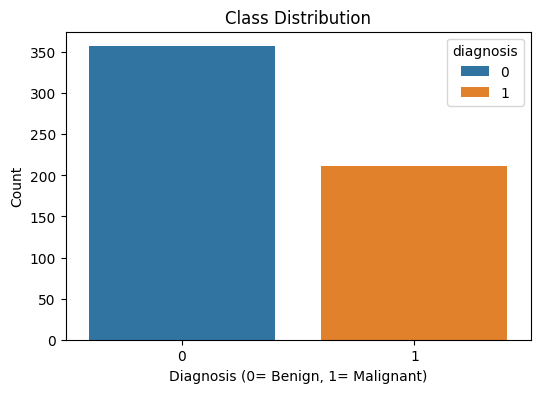

In [ ]:
#Step 1: Import the necessary library
#code attribution

#this code was taken from youtube
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt # Ensure this line is present and executed
import seaborn as sns
from matplotlib import style
from sklearn.linear_model import LogisticRegression
print("Columns after lowercasing:", df.columns.tolist()) # Add this line after lowercasing
plt.figure(figsize=(6, 4)) # Optional: Adjust figure size
sns.countplot(x='diagnosis', data=df, hue='diagnosis')
plt.title('Class Distribution')
plt.xlabel('Diagnosis (0= Benign, 1= Malignant)') # Corrected Plt to plt
plt.ylabel('Count')
plt.show()


In [ ]:
#code attribution

#this code was taken from youtube
# value counts
df.diagnosis.value_counts()

,count
diagnosis,
0,357
1,212


In [ ]:

#Basic stats
#code attribution

#this code was taken from youtube
print(df.describe())

        diagnosis  radius_mean  texture_mean  perimeter_mean    area_mean  \
count  569.000000   569.000000    569.000000      569.000000   569.000000   
mean     0.372583    14.127292     19.289649       91.969033   654.889104   
std      0.483918     3.524049      4.301036       24.298981   351.914129   
min      0.000000     6.981000      9.710000       43.790000   143.500000   
25%      0.000000    11.700000     16.170000       75.170000   420.300000   
50%      0.000000    13.370000     18.840000       86.240000   551.100000   
75%      1.000000    15.780000     21.800000      104.100000   782.700000   
max      1.000000    28.110000     39.280000      188.500000  2501.000000   

       smoothness_mean  compactness_mean  concavity_mean  concave points_mean  \
count       569.000000        569.000000      569.000000           569.000000   
mean          0.096360          0.104341        0.088799             0.048919   
std           0.014064          0.052813        0.079720       

Columns before histogram plot: ['diagnosis', 'radius_mean', 'texture_mean', 'perimeter_mean', 'area_mean', 'smoothness_mean', 'compactness_mean', 'concavity_mean', 'concave points_mean', 'symmetry_mean', 'fractal_dimension_mean', 'radius_se', 'texture_se', 'perimeter_se', 'area_se', 'smoothness_se', 'compactness_se', 'concavity_se', 'concave points_se', 'symmetry_se', 'fractal_dimension_se', 'radius_worst', 'texture_worst', 'perimeter_worst', 'area_worst', 'smoothness_worst', 'compactness_worst', 'concavity_worst', 'concave points_worst', 'symmetry_worst', 'fractal_dimension_worst']


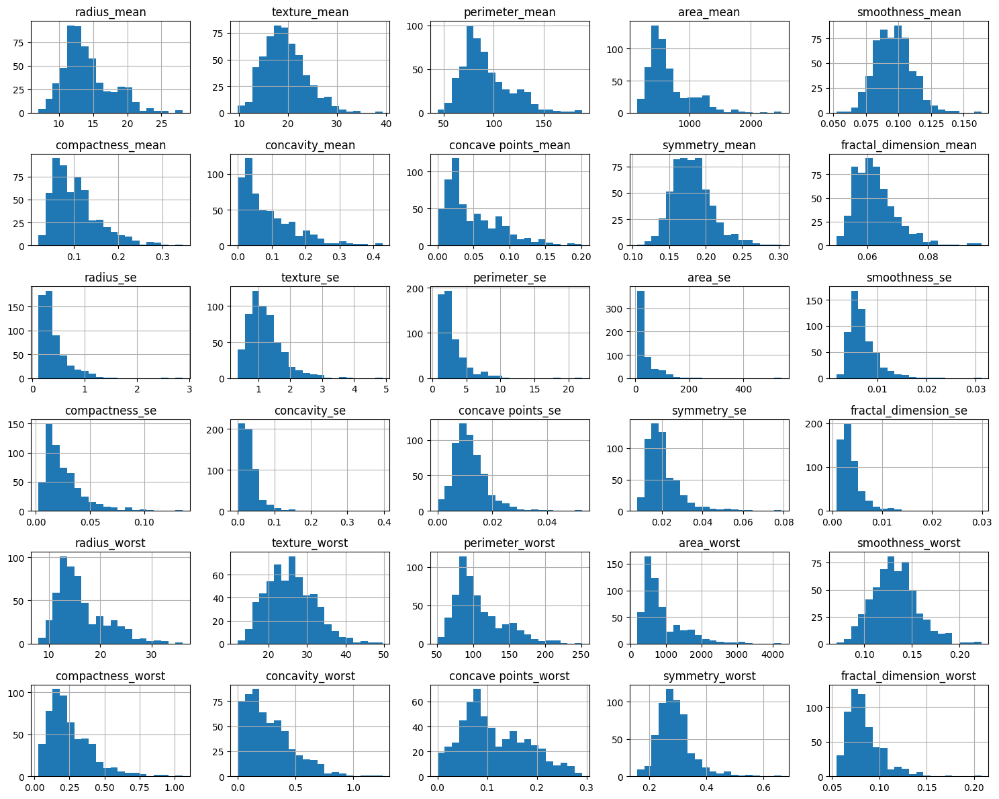

In [ ]:
#Histograms
#code attribution

#this code was taken from youtube
#https://eur03.safelinks.protection.outlook.com/?url=https%3A%2F%2Fyoutu.be%2FSWE9pi4tM9o%3Fsi%3D0y3Ph00jzbTG2eD7&data=05%7C02%7CST10480399%40vcconnect.edu.za%7C6afed60a56c64112a8fc08dd9df855d4%7Ce10c8f44f469448fbc0dd781288ff01b%7C0%7C0%7C638840412147751808%7CUnknown%7CTWFpbGZsb3d8eyJFbXB0eU1hcGkiOnRydWUsIlYiOiIwLjAuMDAwMCIsIlAiOiJXaW4zMiIsIkFOIjoiTWFpbCIsIldUIjoyfQ%3D%3D%7C0%7C%7C%7C&sdata=riB4bif0CKCtwv%2Bud%2FLrW34IL4ld6YRj7TdeaBoVR5w%3D&reserved=0
print("Columns before histogram plot:", df.columns.tolist()) # Add this line to check columns before plotting
if 'diagnosis' in df.columns:
    df.drop('diagnosis', axis=1).hist(figsize=(15,12),bins=20)
    plt.tight_layout()
    plt.show()
else:
    print("The 'diagnosis' column is not found in the DataFrame for histogram plotting.")

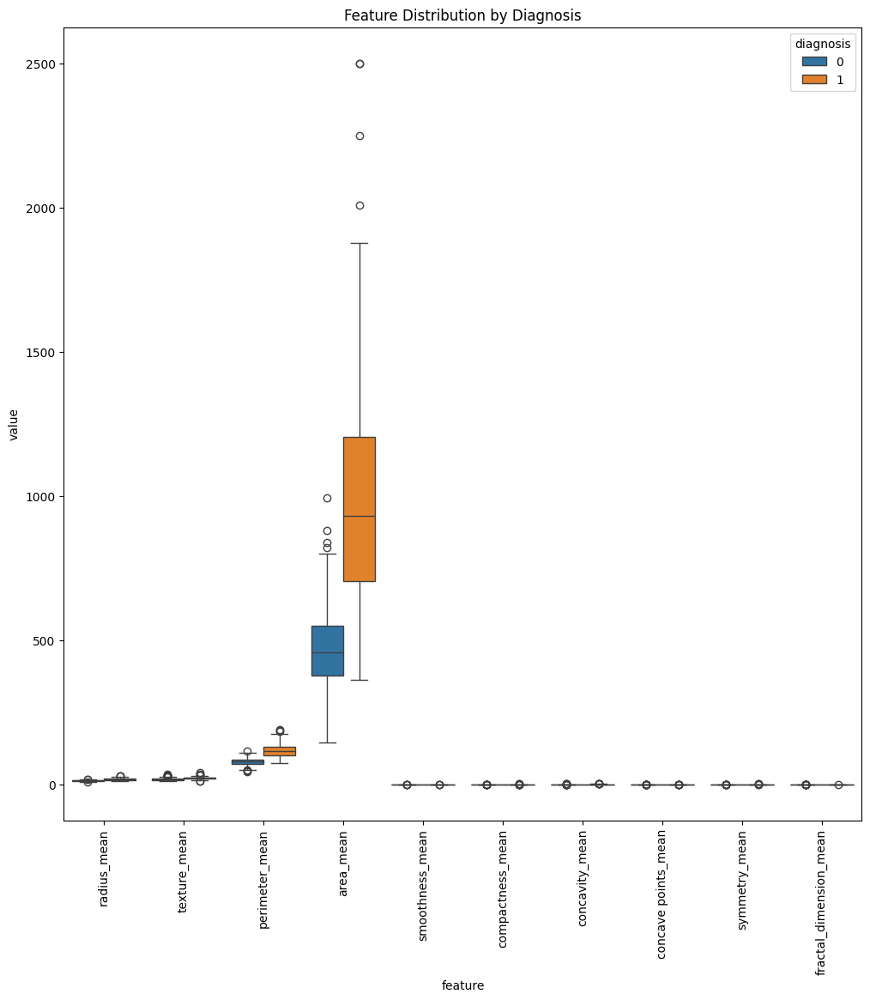

In [ ]:
#code attribution

#this code was taken from youtube
#https://eur03.safelinks.protection.outlook.com/?url=https%3A%2F%2Fyoutu.be%2FSWE9pi4tM9o%3Fsi%3D0y3Ph00jzbTG2eD7&data=05%7C02%7CST10480399%40vcconnect.edu.za%7C6afed60a56c64112a8fc08dd9df855d4%7Ce10c8f44f469448fbc0dd781288ff01b%7C0%7C0%7C638840412147751808%7CUnknown%7CTWFpbGZsb3d8eyJFbXB0eU1hcGkiOnRydWUsIlYiOiIwLjAuMDAwMCIsIlAiOiJXaW4zMiIsIkFOIjoiTWFpbCIsIldUIjoyfQ%3D%3D%7C0%7C%7C%7C&sdata=riB4bif0CKCtwv%2Bud%2FLrW34IL4ld6YRj7TdeaBoVR5w%3D&reserved=0
from sklearn.preprocessing import StandardScaler


#Boxplots to detect outliers
# Select features from index 1 up to (but not including) index 11
features = df.columns[1:11]
plt.figure(figsize=(12,12))

scaler = StandardScaler()
df_scaled = pd.DataFrame(scaler.fit_transform(df[features]), columns=features)

# Melt the DataFrame to long-form for boxplotting
df_melted = pd.melt(df, id_vars='diagnosis', value_vars=features, var_name='feature', value_name='value')

sns.boxplot(x='feature', y='value' ,hue='diagnosis',data=df_melted) # Use the melted DataFrame
# The following line is likely redundant if using seaborn's boxplot on the melted data
# df[features].boxplot(rot=90) # Consider removing this line or plotting it separately if needed
plt.title('Feature Distribution by Diagnosis') # Updated title to reflect selected columns
plt.xticks(rotation=90) # Rotate x-axis labels for better readability
plt.show()

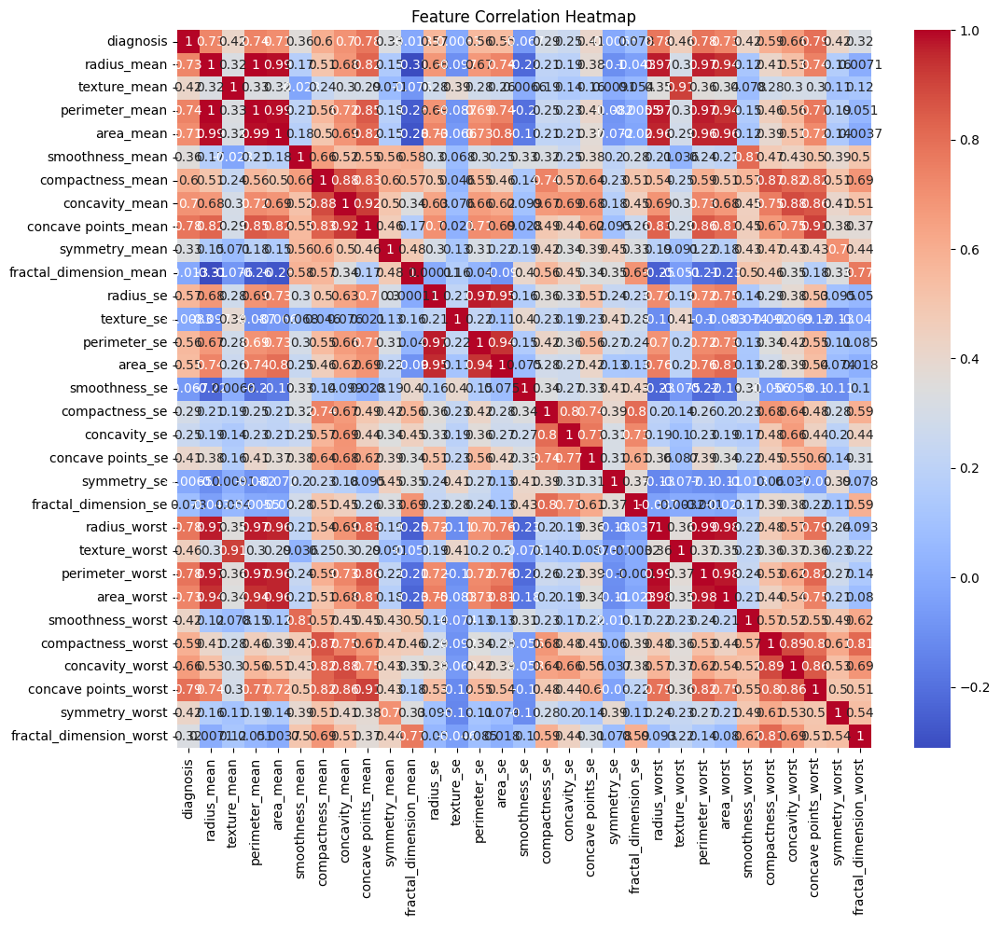

In [ ]:
#code attribution

#this code was taken from youtube
#https://eur03.safelinks.protection.outlook.com/?url=https%3A%2F%2Fyoutu.be%2FSWE9pi4tM9o%3Fsi%3D0y3Ph00jzbTG2eD7&data=05%7C02%7CST10480399%40vcconnect.edu.za%7C6afed60a56c64112a8fc08dd9df855d4%7Ce10c8f44f469448fbc0dd781288ff01b%7C0%7C0%7C638840412147751808%7CUnknown%7CTWFpbGZsb3d8eyJFbXB0eU1hcGkiOnRydWUsIlYiOiIwLjAuMDAwMCIsIlAiOiJXaW4zMiIsIkFOIjoiTWFpbCIsIldUIjoyfQ%3D%3D%7C0%7C%7C%7C&sdata=riB4bif0CKCtwv%2Bud%2FLrW34IL4ld6YRj7TdeaBoVR5w%3D&reserved=0
#Correlation heatmap
import matplotlib.pyplot as plt
import seaborn as sns
plt.figure(figsize=(12,10))
corr=df.corr()
sns.heatmap(corr, annot=True, cmap='coolwarm')
plt.title('Feature Correlation Heatmap')
plt.show()

Columns before heatmap: ['diagnosis', 'radius_mean', 'texture_mean', 'perimeter_mean', 'area_mean', 'smoothness_mean', 'compactness_mean', 'concavity_mean', 'concave points_mean', 'symmetry_mean', 'fractal_dimension_mean', 'radius_se', 'texture_se', 'perimeter_se', 'area_se', 'smoothness_se', 'compactness_se', 'concavity_se', 'concave points_se', 'symmetry_se', 'fractal_dimension_se', 'radius_worst', 'texture_worst', 'perimeter_worst', 'area_worst', 'smoothness_worst', 'compactness_worst', 'concavity_worst', 'concave points_worst', 'symmetry_worst', 'fractal_dimension_worst']


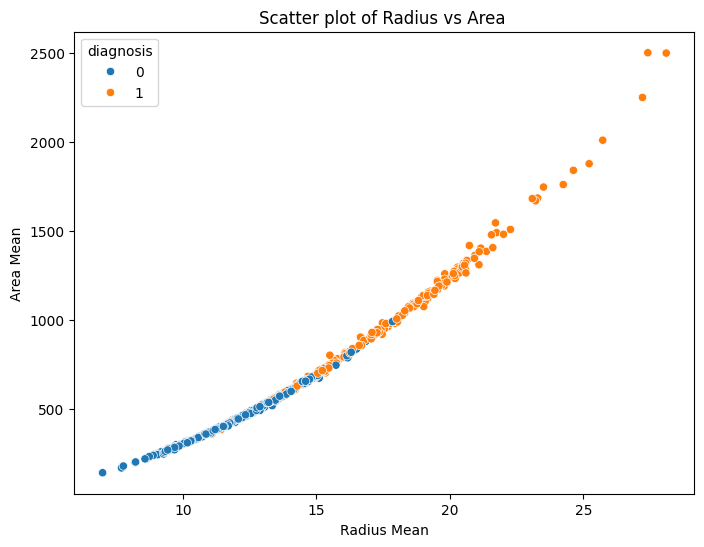

In [ ]:
#Scatterplot
#code attribution

#this code was taken from youtube
#https://eur03.safelinks.protection.outlook.com/?url=https%3A%2F%2Fyoutu.be%2FSWE9pi4tM9o%3Fsi%3D0y3Ph00jzbTG2eD7&data=05%7C02%7CST10480399%40vcconnect.edu.za%7C6afed60a56c64112a8fc08dd9df855d4%7Ce10c8f44f469448fbc0dd781288ff01b%7C0%7C0%7C638840412147751808%7CUnknown%7CTWFpbGZsb3d8eyJFbXB0eU1hcGkiOnRydWUsIlYiOiIwLjAuMDAwMCIsIlAiOiJXaW4zMiIsIkFOIjoiTWFpbCIsIldUIjoyfQ%3D%3D%7C0%7C%7C%7C&sdata=riB4bif0CKCtwv%2Bud%2FLrW34IL4ld6YRj7TdeaBoVR5w%3D&reserved=0
print("Columns before heatmap:", df.columns.tolist()) # Add this line to check columns before plotting
if 'diagnosis' in df.columns:
    plt.figure(figsize=(8,6))
    sns.scatterplot(data=df, x='radius_mean', y='area_mean', hue='diagnosis')
    plt.title('Scatter plot of Radius vs Area ')
    plt.xlabel('Radius Mean')
    plt.ylabel('Area Mean')
    plt.show()


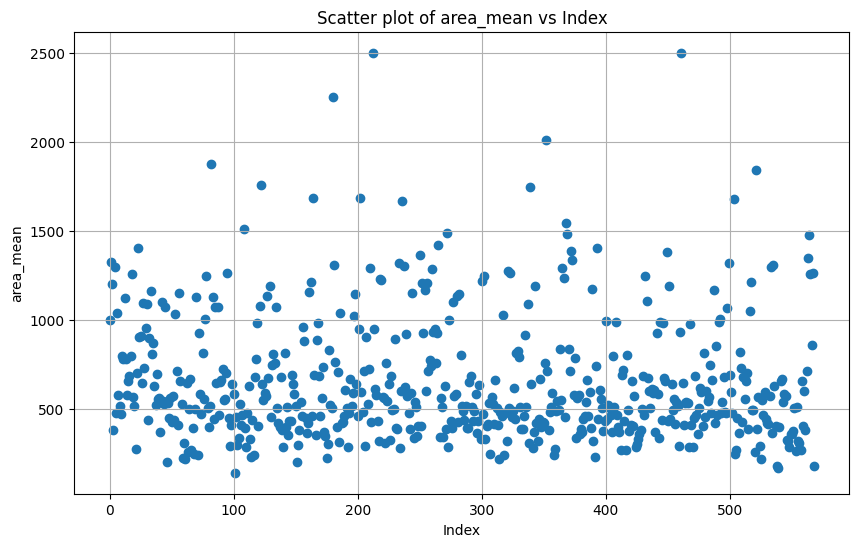

In [ ]:
#code attribution

#this code was taken from youtube
#https://eur03.safelinks.protection.outlook.com/?url=https%3A%2F%2Fyoutu.be%2F2ncx2q5GHbQ%3Fsi%3DyyNk6QDSWshPzsKj&data=05%7C02%7CST10480399%40vcconnect.edu.za%7C77a3d1cbcf07492510ad08dd9dfd40b1%7Ce10c8f44f469448fbc0dd781288ff01b%7C0%7C0%7C638840433277323708%7CUnknown%7CTWFpbGZsb3d8eyJFbXB0eU1hcGkiOnRydWUsIlYiOiIwLjAuMDAwMCIsIlAiOiJXaW4zMiIsIkFOIjoiTWFpbCIsIldUIjoyfQ%3D%3D%7C0%7C%7C%7C&sdata=hPRm0Le7dHT6OLTnM4NrdoBEGnXY7pW4iQHupAqUkm8%3D&reserved=0

#Scatterplot

feature = 'area_mean'
plt.figure(figsize=(10,6))
# Use plt.scatter instead of plt.scatterplot
plt.scatter(df.index, df[feature])
plt.title(f'Scatter plot of {feature} vs Index')
plt.xlabel('Index')
plt.ylabel(feature)
plt.grid(True)
# Also, plt.show() should be a function call
plt.show()

In [ ]:
#code attribution

#this code was taken from youtube
#https://eur03.safelinks.protection.outlook.com/?url=https%3A%2F%2Fyoutu.be%2F2ncx2q5GHbQ%3Fsi%3DyyNk6QDSWshPzsKj&data=05%7C02%7CST10480399%40vcconnect.edu.za%7C77a3d1cbcf07492510ad08dd9dfd40b1%7Ce10c8f44f469448fbc0dd781288ff01b%7C0%7C0%7C638840433277323708%7CUnknown%7CTWFpbGZsb3d8eyJFbXB0eU1hcGkiOnRydWUsIlYiOiIwLjAuMDAwMCIsIlAiOiJXaW4zMiIsIkFOIjoiTWFpbCIsIldUIjoyfQ%3D%3D%7C0%7C%7C%7C&sdata=hPRm0Le7dHT6OLTnM4NrdoBEGnXY7pW4iQHupAqUkm8%3D&reserved=0
#Pairplot
import seaborn as sns
import matplotlib.pyplot as plt

sns.pairplot(df, hue='diagnosis', diag_kind='kde')
plt.suptitle('Pairwise scatter plots of All Features', y=1.02)
plt.show()

Feature selection

In [ ]:
#code attribution

#this code was taken from youtube
#https://eur03.safelinks.protection.outlook.com/?url=https%3A%2F%2Fyoutu.be%2F2ncx2q5GHbQ%3Fsi%3DyyNk6QDSWshPzsKj&data=05%7C02%7CST10480399%40vcconnect.edu.za%7C77a3d1cbcf07492510ad08dd9dfd40b1%7Ce10c8f44f469448fbc0dd781288ff01b%7C0%7C0%7C638840433277323708%7CUnknown%7CTWFpbGZsb3d8eyJFbXB0eU1hcGkiOnRydWUsIlYiOiIwLjAuMDAwMCIsIlAiOiJXaW4zMiIsIkFOIjoiTWFpbCIsIldUIjoyfQ%3D%3D%7C0%7C%7C%7C&sdata=hPRm0Le7dHT6OLTnM4NrdoBEGnXY7pW4iQHupAqUkm8%3D&reserved=0

from sklearn.metrics import classification_report,confusion_matrix, accuracy_score,roc_auc_score, precision_score, f1_score, ConfusionMatrixDisplay
import matplotlib.pyplot as plt # Import matplotlib for plotting
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import StandardScaler

# Check if 'diagnosis' column exists and the necessary variables are defined
if 'diagnosis' in df.columns and 'X_train' in globals() and 'y_train' in globals() and 'X_test' in globals() and 'y_test' in globals() and 'selected_features' in globals():

    scaler=StandardScaler()
    X_train_scaled = scaler.fit_transform(X_train)
    X_test_scaled = scaler.transform(X_test)

    Model= RandomForestClassifier(n_estimators=100, random_state=42)
    Model.fit(X_train_scaled, y_train)

    #Predictions
    y_pred=Model.predict(X_test_scaled)
    y_pred_prob=Model.predict_proba(X_test_scaled)[:,1]

    #Evaluation metrics
    print('Classification Report:\n', classification_report(y_test, y_pred))
    print('Accuracy score :', accuracy_score(y_test, y_pred))
    print('Precision score :', precision_score(y_test, y_pred))
    print('F1 score :', f1_score(y_test, y_pred))
    print('ROC AUC score :', roc_auc_score(y_test, y_pred_prob))

    #confusion Matrix
    ConfusionMatrixDisplay(confusion_matrix=confusion_matrix(y_test, y_pred)).plot(cmap='Blues')
    plt.title('Confusion Matrix')
    plt.show()

In [ ]:
#code attribution

#this code was taken from youtube
#https://eur03.safelinks.protection.outlook.com/?url=https%3A%2F%2Fyoutu.be%2F2ncx2q5GHbQ%3Fsi%3DyyNk6QDSWshPzsKj&data=05%7C02%7CST10480399%40vcconnect.edu.za%7C77a3d1cbcf07492510ad08dd9dfd40b1%7Ce10c8f44f469448fbc0dd781288ff01b%7C0%7C0%7C638840433277323708%7CUnknown%7CTWFpbGZsb3d8eyJFbXB0eU1hcGkiOnRydWUsIlYiOiIwLjAuMDAwMCIsIlAiOiJXaW4zMiIsIkFOIjoiTWFpbCIsIldUIjoyfQ%3D%3D%7C0%7C%7C%7C&sdata=hPRm0Le7dHT6OLTnM4NrdoBEGnXY7pW4iQHupAqUkm8%3D&reserved=0

from sklearn.feature_selection import SelectKBest, f_classif
# Indent the following lines
x = df.drop('diagnosis', axis=1)
y = df['diagnosis']

In [ ]:
#code attribution

#this code was taken from youtube
#https://eur03.safelinks.protection.outlook.com/?url=https%3A%2F%2Fyoutu.be%2F2ncx2q5GHbQ%3Fsi%3DyyNk6QDSWshPzsKj&data=05%7C02%7CST10480399%40vcconnect.edu.za%7C77a3d1cbcf07492510ad08dd9dfd40b1%7Ce10c8f44f469448fbc0dd781288ff01b%7C0%7C0%7C638840433277323708%7CUnknown%7CTWFpbGZsb3d8eyJFbXB0eU1hcGkiOnRydWUsIlYiOiIwLjAuMDAwMCIsIlAiOiJXaW4zMiIsIkFOIjoiTWFpbCIsIldUIjoyfQ%3D%3D%7C0%7C%7C%7C&sdata=hPRm0Le7dHT6OLTnM4NrdoBEGnXY7pW4iQHupAqUkm8%3D&reserved=0

#use selectkbest to get top features
if 'diagnosis' in df.columns:
    y = df['diagnosis']
    x = df.drop('diagnosis', axis=1)
    selector = SelectKBest(score_func=f_classif, k=10)
    x_new = selector.fit_transform(x,y)

In [ ]:
#code attribution

#this code was taken from youtube
#https://eur03.safelinks.protection.outlook.com/?url=https%3A%2F%2Fyoutu.be%2FSWE9pi4tM9o%3Fsi%3D0y3Ph00jzbTG2eD7&data=05%7C02%7CST10480399%40vcconnect.edu.za%7C6afed60a56c64112a8fc08dd9df855d4%7Ce10c8f44f469448fbc0dd781288ff01b%7C0%7C0%7C638840412147751808%7CUnknown%7CTWFpbGZsb3d8eyJFbXB0eU1hcGkiOnRydWUsIlYiOiIwLjAuMDAwMCIsIlAiOiJXaW4zMiIsIkFOIjoiTWFpbCIsIldUIjoyfQ%3D%3D%7C0%7C%7C%7C&sdata=riB4bif0CKCtwv%2Bud%2FLrW34IL4ld6YRj7TdeaBoVR5w%3D&reserved=0

from sklearn.feature_selection import SelectKBest, f_classif
#Get selected feature names
if 'diagnosis' in df.columns:
    y = df['diagnosis']
    x = df.drop('diagnosis', axis=1)
    y = df['diagnosis']
    selector = SelectKBest(score_func=f_classif, k=10)
    # Ensure this fit method is executed before get_support()
    selector.fit(x, y)
    mask = selector.get_support()
    selected_features = x.columns[mask]
    print('Top 10 selected features:\n', selected_features)

Top 10 selected features:
 Index(['radius_mean', 'perimeter_mean', 'area_mean', 'concavity_mean',
       'concave points_mean', 'radius_worst', 'perimeter_worst', 'area_worst',
       'concavity_worst', 'concave points_worst'],
      dtype='object')


# Mode training

Top 10 selected features:
 Index(['radius_mean', 'perimeter_mean', 'area_mean', 'concavity_mean',
       'concave points_mean', 'radius_worst', 'perimeter_worst', 'area_worst',
       'concavity_worst', 'concave points_worst'],
      dtype='object')

Training Logistic Regression Model...

Logistic Regression Model Evaluation:
Classification Report:
               precision    recall  f1-score   support

           0       0.99      0.97      0.98        71
           1       0.95      0.98      0.97        43

    accuracy                           0.97       114
   macro avg       0.97      0.97      0.97       114
weighted avg       0.97      0.97      0.97       114

Accuracy score : 0.9736842105263158
Precision score : 0.9545454545454546
F1 score : 0.9655172413793104
ROC AUC score : 0.9980347199475925


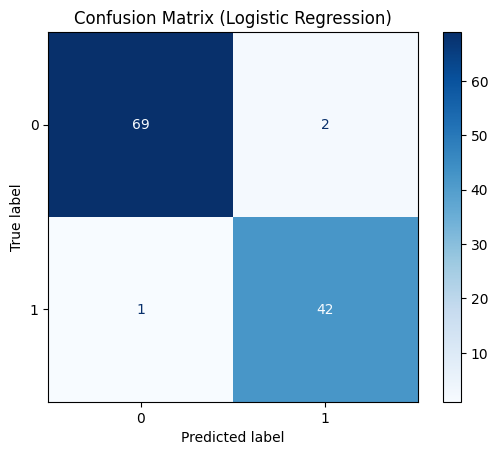


Training Random Forest Model...

Random Forest Model Evaluation:
Classification Report:
               precision    recall  f1-score   support

           0       0.96      0.97      0.97        71
           1       0.95      0.93      0.94        43

    accuracy                           0.96       114
   macro avg       0.96      0.95      0.95       114
weighted avg       0.96      0.96      0.96       114

Accuracy score : 0.956140350877193
Precision score : 0.9523809523809523
F1 score : 0.9411764705882353
ROC AUC score : 0.9952505732066819


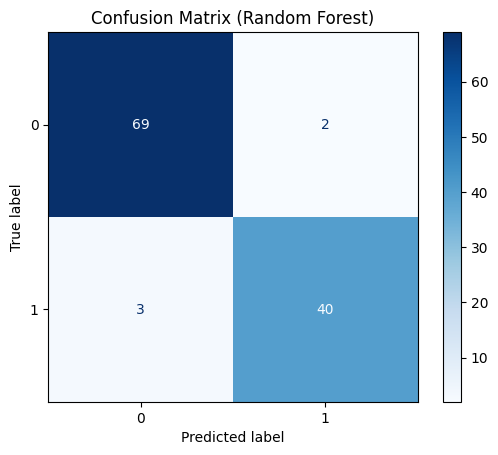

In [ ]:
#code attribution

#this code was taken from youtube
#https://eur03.safelinks.protection.outlook.com/?url=https%3A%2F%2Fyoutu.be%2F2ncx2q5GHbQ%3Fsi%3DyyNk6QDSWshPzsKj&data=05%7C02%7CST10480399%40vcconnect.edu.za%7C77a3d1cbcf07492510ad08dd9dfd40b1%7Ce10c8f44f469448fbc0dd781288ff01b%7C0%7C0%7C638840433277323708%7CUnknown%7CTWFpbGZsb3d8eyJFbXB0eU1hcGkiOnRydWUsIlYiOiIwLjAuMDAwMCIsIlAiOiJXaW4zMiIsIkFOIjoiTWFpbCIsIldUIjoyfQ%3D%3D%7C0%7C%7C%7C&sdata=hPRm0Le7dHT6OLTnM4NrdoBEGnXY7pW4iQHupAqUkm8%3D&reserved=0

from sklearn.feature_selection import SelectKBest, f_classif
from sklearn.model_selection import train_test_split # Import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score, roc_auc_score, precision_score, f1_score, ConfusionMatrixDisplay
import matplotlib.pyplot as plt # Import matplotlib for plotting


# Assuming 'df' is your pandas DataFrame with 'diagnosis' column
if 'diagnosis' in df.columns:
    # Separate features (x) and target (y)
    y = df['diagnosis']
    x = df.drop('diagnosis', axis=1)

    # Use selectkbest to get top features
    selector = SelectKBest(score_func=f_classif, k=10)
    x_new = selector.fit_transform(x, y)

    # Get selected feature names
    mask = selector.get_support()
    selected_features = x.columns[mask]
    print('Top 10 selected features:\n', selected_features)

    # Split the data into training and testing sets
    X_train, X_test, y_train, y_test = train_test_split(x_new, y, test_size=0.2, random_state=42) # Using x_new (selected features)

    # Scale the features
    scaler = StandardScaler()
    X_train_scaled = scaler.fit_transform(X_train)
    X_test_scaled = scaler.transform(X_test)

    # Train a Logistic Regression model (example)
    print("\nTraining Logistic Regression Model...")
    log_reg_model = LogisticRegression()
    log_reg_model.fit(X_train_scaled, y_train)

    # Evaluate Logistic Regression model
    print("\nLogistic Regression Model Evaluation:")
    y_pred_log_reg = log_reg_model.predict(X_test_scaled)
    y_pred_prob_log_reg = log_reg_model.predict_proba(X_test_scaled)[:, 1]
    print('Classification Report:\n', classification_report(y_test, y_pred_log_reg))
    print('Accuracy score :', accuracy_score(y_test, y_pred_log_reg))
    print('Precision score :', precision_score(y_test, y_pred_log_reg))
    print('F1 score :', f1_score(y_test, y_pred_log_reg))
    print('ROC AUC score :', roc_auc_score(y_test, y_pred_prob_log_reg))

    # Confusion Matrix for Logistic Regression
    ConfusionMatrixDisplay(confusion_matrix=confusion_matrix(y_test, y_pred_log_reg)).plot(cmap='Blues')
    plt.title('Confusion Matrix (Logistic Regression)')
    plt.show()

    # Train a Random Forest model (example)
    print("\nTraining Random Forest Model...")
    rf_model = RandomForestClassifier(n_estimators=100, random_state=42)
    rf_model.fit(X_train_scaled, y_train)

    # Evaluate Random Forest model
    print("\nRandom Forest Model Evaluation:")
    y_pred_rf = rf_model.predict(X_test_scaled)
    y_pred_prob_rf = rf_model.predict_proba(X_test_scaled)[:, 1]
    print('Classification Report:\n', classification_report(y_test, y_pred_rf))
    print('Accuracy score :', accuracy_score(y_test, y_pred_rf))
    print('Precision score :', precision_score(y_test, y_pred_rf))
    print('F1 score :', f1_score(y_test, y_pred_rf))
    print('ROC AUC score :', roc_auc_score(y_test, y_pred_prob_rf))

    # Confusion Matrix for Random Forest
    ConfusionMatrixDisplay(confusion_matrix=confusion_matrix(y_test, y_pred_rf)).plot(cmap='Blues')
    plt.title('Confusion Matrix (Random Forest)')
    plt.show()


In [ ]:
#code attribution

#this code was taken from youtube
#https://eur03.safelinks.protection.outlook.com/?url=https%3A%2F%2Fyoutu.be%2FSWE9pi4tM9o%3Fsi%3D0y3Ph00jzbTG2eD7&data=05%7C02%7CST10480399%40vcconnect.edu.za%7C6afed60a56c64112a8fc08dd9df855d4%7Ce10c8f44f469448fbc0dd781288ff01b%7C0%7C0%7C638840412147751808%7CUnknown%7CTWFpbGZsb3d8eyJFbXB0eU1hcGkiOnRydWUsIlYiOiIwLjAuMDAwMCIsIlAiOiJXaW4zMiIsIkFOIjoiTWFpbCIsIldUIjoyfQ%3D%3D%7C0%7C%7C%7C&sdata=riB4bif0CKCtwv%2Bud%2FLrW34IL4ld6YRj7TdeaBoVR5w%3D&reserved=0
from sklearn.preprocessing import StandardScaler
if 'diagnosis' in df.columns:
    y = df['diagnosis']
    scaler=StandardScaler()
    X_train_scaled=scaler.fit_transform(X_train)
    X_test_scaled=scaler.transform(X_test)

In [ ]:
#code attribution

#this code was taken from youtube
#https://eur03.safelinks.protection.outlook.com/?url=https%3A%2F%2Fyoutu.be%2FSWE9pi4tM9o%3Fsi%3D0y3Ph00jzbTG2eD7&data=05%7C02%7CST10480399%40vcconnect.edu.za%7C6afed60a56c64112a8fc08dd9df855d4%7Ce10c8f44f469448fbc0dd781288ff01b%7C0%7C0%7C638840412147751808%7CUnknown%7CTWFpbGZsb3d8eyJFbXB0eU1hcGkiOnRydWUsIlYiOiIwLjAuMDAwMCIsIlAiOiJXaW4zMiIsIkFOIjoiTWFpbCIsIldUIjoyfQ%3D%3D%7C0%7C%7C%7C&sdata=riB4bif0CKCtwv%2Bud%2FLrW34IL4ld6YRj7TdeaBoVR5w%3D&reserved=0
from sklearn.linear_model import LogisticRegression
if 'diagnosis' in df.columns:
    y = df['diagnosis']
    Model=LogisticRegression()
    Model.fit(X_train_scaled, y_train)

In [ ]:
#code attribution

#this code was taken from youtube
#https://eur03.safelinks.protection.outlook.com/?url=https%3A%2F%2Fyoutu.be%2FSWE9pi4tM9o%3Fsi%3D0y3Ph00jzbTG2eD7&data=05%7C02%7CST10480399%40vcconnect.edu.za%7C6afed60a56c64112a8fc08dd9df855d4%7Ce10c8f44f469448fbc0dd781288ff01b%7C0%7C0%7C638840412147751808%7CUnknown%7CTWFpbGZsb3d8eyJFbXB0eU1hcGkiOnRydWUsIlYiOiIwLjAuMDAwMCIsIlAiOiJXaW4zMiIsIkFOIjoiTWFpbCIsIldUIjoyfQ%3D%3D%7C0%7C%7C%7C&sdata=riB4bif0CKCtwv%2Bud%2FLrW34IL4ld6YRj7TdeaBoVR5w%3D&reserved=0
from sklearn.metrics import classification_report,confusion_matrix, accuracy_score,roc_auc_score, precision_score, f1_score, ConfusionMatrixDisplay
import matplotlib.pyplot as plt # Import matplotlib for plotting
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import StandardScaler

In [ ]:
#code attribution

#this code was taken from youtube
#https://eur03.safelinks.protection.outlook.com/?url=https%3A%2F%2Fyoutu.be%2FSWE9pi4tM9o%3Fsi%3D0y3Ph00jzbTG2eD7&data=05%7C02%7CST10480399%40vcconnect.edu.za%7C6afed60a56c64112a8fc08dd9df855d4%7Ce10c8f44f469448fbc0dd781288ff01b%7C0%7C0%7C638840412147751808%7CUnknown%7CTWFpbGZsb3d8eyJFbXB0eU1hcGkiOnRydWUsIlYiOiIwLjAuMDAwMCIsIlAiOiJXaW4zMiIsIkFOIjoiTWFpbCIsIldUIjoyfQ%3D%3D%7C0%7C%7C%7C&sdata=riB4bif0CKCtwv%2Bud%2FLrW34IL4ld6YRj7TdeaBoVR5w%3D&reserved=0
#Train Random Frest
from sklearn.ensemble import RandomForestClassifier
if 'diagnosis' in df.columns:
    y = df['diagnosis']
    Model= RandomForestClassifier(n_estimators=100, random_state=42)
    Model.fit(X_train_scaled, y_train)


# Model Evaluation

Classification Report:
               precision    recall  f1-score   support

           0       0.96      0.97      0.97        71
           1       0.95      0.93      0.94        43

    accuracy                           0.96       114
   macro avg       0.96      0.95      0.95       114
weighted avg       0.96      0.96      0.96       114

Accuracy score : 0.956140350877193
Precision score : 0.9523809523809523
F1 score : 0.9411764705882353
ROC AUC score : 0.9952505732066819


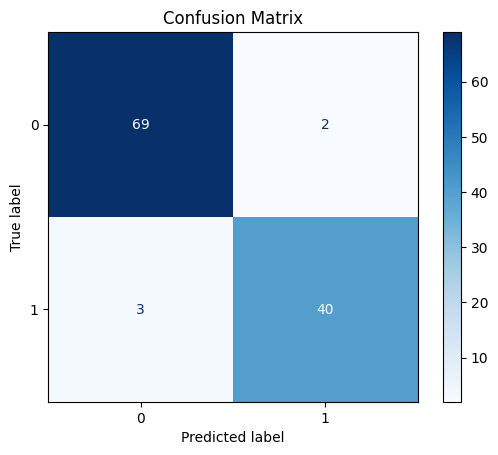

In [ ]:
#code attribution

#this code was taken from youtube
#https://eur03.safelinks.protection.outlook.com/?url=https%3A%2F%2Fyoutu.be%2F2ncx2q5GHbQ%3Fsi%3DyyNk6QDSWshPzsKj&data=05%7C02%7CST10480399%40vcconnect.edu.za%7C77a3d1cbcf07492510ad08dd9dfd40b1%7Ce10c8f44f469448fbc0dd781288ff01b%7C0%7C0%7C638840433277323708%7CUnknown%7CTWFpbGZsb3d8eyJFbXB0eU1hcGkiOnRydWUsIlYiOiIwLjAuMDAwMCIsIlAiOiJXaW4zMiIsIkFOIjoiTWFpbCIsIldUIjoyfQ%3D%3D%7C0%7C%7C%7C&sdata=hPRm0Le7dHT6OLTnM4NrdoBEGnXY7pW4iQHupAqUkm8%3D&reserved=0
from sklearn.metrics import classification_report,confusion_matrix, accuracy_score,roc_auc_score, precision_score, f1_score, ConfusionMatrixDisplay
import matplotlib.pyplot as plt # Import matplotlib for plotting
from sklearn.preprocessing import StandardScaler

# Check if 'diagnosis' column exists and the necessary variables are defined
if 'diagnosis' in df.columns and 'X_train' in globals() and 'y_train' in globals() and 'X_test' in globals() and 'y_test' in globals() and 'selected_features' in globals():

    scaler=StandardScaler()
    X_train_scaled = scaler.fit_transform(X_train)
    X_test_scaled = scaler.transform(X_test)

    Model= RandomForestClassifier(n_estimators=100, random_state=42)
    Model.fit(X_train_scaled, y_train)

    #Predictions
    y_pred=Model.predict(X_test_scaled)
    y_pred_prob=Model.predict_proba(X_test_scaled)[:,1]

    #Evaluation metrics
    print('Classification Report:\n', classification_report(y_test, y_pred))
    print('Accuracy score :', accuracy_score(y_test, y_pred))
    print('Precision score :', precision_score(y_test, y_pred))
    print('F1 score :', f1_score(y_test, y_pred))
    print('ROC AUC score :', roc_auc_score(y_test, y_pred_prob))

    #confusion Matrix
    ConfusionMatrixDisplay(confusion_matrix=confusion_matrix(y_test, y_pred)).plot(cmap='Blues')
    plt.title('Confusion Matrix')
    plt.show()

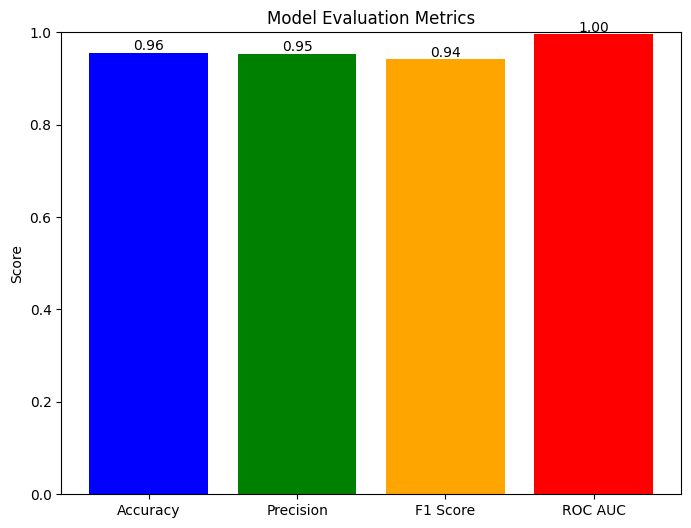

In [ ]:
#code attribution

#this code was taken from youtube
#https://eur03.safelinks.protection.outlook.com/?url=https%3A%2F%2Fyoutu.be%2F2ncx2q5GHbQ%3Fsi%3DyyNk6QDSWshPzsKj&data=05%7C02%7CST10480399%40vcconnect.edu.za%7C77a3d1cbcf07492510ad08dd9dfd40b1%7Ce10c8f44f469448fbc0dd781288ff01b%7C0%7C0%7C638840433277323708%7CUnknown%7CTWFpbGZsb3d8eyJFbXB0eU1hcGkiOnRydWUsIlYiOiIwLjAuMDAwMCIsIlAiOiJXaW4zMiIsIkFOIjoiTWFpbCIsIldUIjoyfQ%3D%3D%7C0%7C%7C%7C&sdata=hPRm0Le7dHT6OLTnM4NrdoBEGnXY7pW4iQHupAqUkm8%3D&reserved=0
metrics = ['Accuracy', 'Precision', 'F1 Score', 'ROC AUC']
scores = [
    accuracy_score(y_test, y_pred),
    precision_score(y_test, y_pred),
    f1_score(y_test, y_pred),
    roc_auc_score(y_test, y_pred_prob)
]

plt.figure(figsize=(8, 6))
plt.bar(metrics, scores, color=['blue', 'green', 'orange', 'red'])
plt.ylabel('Score')
plt.title('Model Evaluation Metrics')
plt.ylim(0, 1) # Assuming scores are between 0 and 1
for i, v in enumerate(scores):
    plt.text(i, v, f'{v:.2f}', ha='center', va='bottom')
plt.show()

In [ ]:
#code attribution

#this code was taken from youtube
#https://eur03.safelinks.protection.outlook.com/?url=https%3A%2F%2Fyoutu.be%2FSWE9pi4tM9o%3Fsi%3D0y3Ph00jzbTG2eD7&data=05%7C02%7CST10480399%40vcconnect.edu.za%7C6afed60a56c64112a8fc08dd9df855d4%7Ce10c8f44f469448fbc0dd781288ff01b%7C0%7C0%7C638840412147751808%7CUnknown%7CTWFpbGZsb3d8eyJFbXB0eU1hcGkiOnRydWUsIlYiOiIwLjAuMDAwMCIsIlAiOiJXaW4zMiIsIkFOIjoiTWFpbCIsIldUIjoyfQ%3D%3D%7C0%7C%7C%7C&sdata=riB4bif0CKCtwv%2Bud%2FLrW34IL4ld6YRj7TdeaBoVR5w%3D&reserved=0
from sklearn.metrics import roc_auc_score, classification_report, confusion_matrix, ConfusionMatrixDisplay
from sklearn.model_selection import GridSearchCV # Import GridSearchCV
from sklearn.preprocessing import StandardScaler

if 'diagnosis' in df.columns:
  scaler=StandardScaler()
  X_train_scaled = scaler.fit_transform(X_train)
  X_test_scaled = scaler.transform(X_test)
  param_grid = {
      'n_estimators': [100,200],
      'max_depth': [None, 5, 10],
      'min_samples_split': [2, 5],
  }
  grid = GridSearchCV(RandomForestClassifier(random_state=42), param_grid, cv=5, scoring= 'roc_auc')
  grid.fit(X_train_scaled, y_train)
  print(grid.best_params_)
  #Best model evaluation
  best_model = grid.best_estimator_

  print ('Best parameters:', grid.best_params_) # Also added parenthesis for print function
  y_pred_best = best_model.predict(X_test_scaled)
  y_proba_best = best_model.predict_proba(X_test_scaled)[:,1]
  print('Tuned Model ROC AUC score:', roc_auc_score(y_test, y_proba_best))

{'max_depth': 5, 'min_samples_split': 2, 'n_estimators': 200}
Best parameters: {'max_depth': 5, 'min_samples_split': 2, 'n_estimators': 200}
Tuned Model ROC AUC score: 0.9954143465443825


Accuracy: 0.956140350877193
              precision    recall  f1-score   support

           0       0.96      0.97      0.97        71
           1       0.95      0.93      0.94        43

    accuracy                           0.96       114
   macro avg       0.96      0.95      0.95       114
weighted avg       0.96      0.96      0.96       114

[[69  2]
 [ 3 40]]


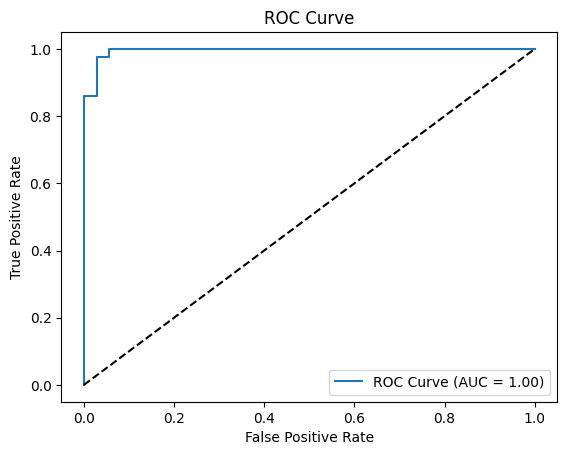

In [ ]:
#code attribution

#this code was taken from youtube
#https://eur03.safelinks.protection.outlook.com/?url=https%3A%2F%2Fyoutu.be%2FSWE9pi4tM9o%3Fsi%3D0y3Ph00jzbTG2eD7&data=05%7C02%7CST10480399%40vcconnect.edu.za%7C6afed60a56c64112a8fc08dd9df855d4%7Ce10c8f44f469448fbc0dd781288ff01b%7C0%7C0%7C638840412147751808%7CUnknown%7CTWFpbGZsb3d8eyJFbXB0eU1hcGkiOnRydWUsIlYiOiIwLjAuMDAwMCIsIlAiOiJXaW4zMiIsIkFOIjoiTWFpbCIsIldUIjoyfQ%3D%3D%7C0%7C%7C%7C&sdata=riB4bif0CKCtwv%2Bud%2FLrW34IL4ld6YRj7TdeaBoVR5w%3D&reserved=0
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score
from sklearn.metrics import roc_curve, auc
import matplotlib.pyplot as plt

# Assuming 'best_model' is defined in the previous cell after GridSearchCV
# It seems the intention was to use the 'best_model' from the GridSearchCV
y_pred = best_model.predict(X_test_scaled) # Use X_test_scaled as the model was trained on scaled data
print("Accuracy:", accuracy_score(y_test, y_pred))
print(classification_report(y_test, y_pred))
print(confusion_matrix(y_test, y_pred))

y_prob = best_model.predict_proba(X_test_scaled)[:, 1] # Use X_test_scaled
fpr, tpr, thresholds = roc_curve(y_test, y_prob)
roc_auc = auc(fpr, tpr)

plt.plot(fpr, tpr, label=f'ROC Curve (AUC = {roc_auc:.2f})')
plt.plot([0, 1], [0, 1], 'k--')
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.title("ROC Curve")
plt.legend()
plt.show()


In [ ]:
#code attribution

#this code was taken from youtube
#https://eur03.safelinks.protection.outlook.com/?url=https%3A%2F%2Fyoutu.be%2FSWE9pi4tM9o%3Fsi%3D0y3Ph00jzbTG2eD7&data=05%7C02%7CST10480399%40vcconnect.edu.za%7C6afed60a56c64112a8fc08dd9df855d4%7Ce10c8f44f469448fbc0dd781288ff01b%7C0%7C0%7C638840412147751808%7CUnknown%7CTWFpbGZsb3d8eyJFbXB0eU1hcGkiOnRydWUsIlYiOiIwLjAuMDAwMCIsIlAiOiJXaW4zMiIsIkFOIjoiTWFpbCIsIldUIjoyfQ%3D%3D%7C0%7C%7C%7C&sdata=riB4bif0CKCtwv%2Bud%2FLrW34IL4ld6YRj7TdeaBoVR5w%3D&reserved=0
from sklearn.model_selection import GridSearchCV

params = {
    'n_estimators': [50, 100, 200],
    'max_depth': [None, 10, 20],
    'min_samples_split': [2, 5]
}

grid = GridSearchCV(RandomForestClassifier(random_state=42), params, cv=5)
grid.fit(X_train, y_train)
print("Best parameters:", grid.best_params_)

# Retrain with best model
best_model = grid.best_estimator_
y_pred_best = best_model.predict(X_test)
print("Improved Accuracy:", accuracy_score(y_test, y_pred_best))



Best parameters: {'max_depth': None, 'min_samples_split': 2, 'n_estimators': 50}
Improved Accuracy: 0.956140350877193
